In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import folium
import branca.colormap as cm
from folium.plugins import MarkerCluster
import matplotlib.pyplot as plt
import plotly
import plotly.express as px

In [2]:
all_data = pd.read_csv("covidconfirmed.csv")

In [3]:
print(len(all_data)) #check number of rows
print(len(all_data.columns)) #check number of columns

3193
882


In [4]:
all_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3193 entries, 0 to 3192
Columns: 882 entries, countyFIPS to 17/06/2022
dtypes: int64(880), object(2)
memory usage: 21.5+ MB


In [5]:
all_data.isnull().values.any() #check for missing values

False

In [6]:
fl = all_data.loc[all_data["State"] =="FL"]
fl = fl.iloc[1: , :]
fl

,countyFIPS,County Name,State,StateFIPS,22/01/2020,23/01/2020,24/01/2020,25/01/2020,26/01/2020,27/01/2020,...,08/06/2022,09/06/2022,10/06/2022,11/06/2022,12/06/2022,13/06/2022,14/06/2022,15/06/2022,16/06/2022,17/06/2022
330,12001,Alachua County,FL,12,0,0,0,0,0,0,...,71531,71531,71531,71531,71531,71531,71531,71531,71531,73353
331,12003,Baker County,FL,12,0,0,0,0,0,0,...,8786,8786,8786,8786,8786,8786,8786,8786,8786,8890
332,12005,Bay County,FL,12,0,0,0,0,0,0,...,46729,46729,46729,46729,46729,46729,46729,46729,46729,47484
333,12007,Bradford County,FL,12,0,0,0,0,0,0,...,7639,7639,7639,7639,7639,7639,7639,7639,7639,7723
334,12009,Brevard County,FL,12,0,0,0,0,0,0,...,141879,141879,141879,141879,141879,141879,141879,141879,141879,145889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
392,12125,Union County,FL,12,0,0,0,0,0,0,...,4354,4354,4354,4354,4354,4354,4354,4354,4354,4396
393,12127,Volusia County,FL,12,0,0,0,0,0,0,...,122496,122496,122496,122496,122496,122496,122496,122496,122496,125956
394,12129,Wakulla County,FL,12,0,0,0,0,0,0,...,10158,10158,10158,10158,10158,10158,10158,10158,10158,10298
395,12131,Walton County,FL,12,0,0,0,0,0,0,...,16858,16858,16858,16858,16858,16858,16858,16858,16858,17101


In [7]:
fl_total = fl
fl_total = fl_total.drop(['countyFIPS', 'StateFIPS'], axis=1)
fl_total

,County Name,State,22/01/2020,23/01/2020,24/01/2020,25/01/2020,26/01/2020,27/01/2020,28/01/2020,29/01/2020,...,08/06/2022,09/06/2022,10/06/2022,11/06/2022,12/06/2022,13/06/2022,14/06/2022,15/06/2022,16/06/2022,17/06/2022
330,Alachua County,FL,0,0,0,0,0,0,0,0,...,71531,71531,71531,71531,71531,71531,71531,71531,71531,73353
331,Baker County,FL,0,0,0,0,0,0,0,0,...,8786,8786,8786,8786,8786,8786,8786,8786,8786,8890
332,Bay County,FL,0,0,0,0,0,0,0,0,...,46729,46729,46729,46729,46729,46729,46729,46729,46729,47484
333,Bradford County,FL,0,0,0,0,0,0,0,0,...,7639,7639,7639,7639,7639,7639,7639,7639,7639,7723
334,Brevard County,FL,0,0,0,0,0,0,0,0,...,141879,141879,141879,141879,141879,141879,141879,141879,141879,145889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
392,Union County,FL,0,0,0,0,0,0,0,0,...,4354,4354,4354,4354,4354,4354,4354,4354,4354,4396
393,Volusia County,FL,0,0,0,0,0,0,0,0,...,122496,122496,122496,122496,122496,122496,122496,122496,122496,125956
394,Wakulla County,FL,0,0,0,0,0,0,0,0,...,10158,10158,10158,10158,10158,10158,10158,10158,10158,10298
395,Walton County,FL,0,0,0,0,0,0,0,0,...,16858,16858,16858,16858,16858,16858,16858,16858,16858,17101


### graphing by county

In [8]:
fl_tr = fl_total.T
fl_tr.reset_index(drop=True)
fl_tr.head()

,330,331,332,333,334,335,336,337,338,339,...,387,388,389,390,391,392,393,394,395,396
County Name,Alachua County,Baker County,Bay County,Bradford County,Brevard County,Broward County,Calhoun County,Charlotte County,Citrus County,Clay County,...,Sarasota County,Seminole County,Sumter County,Suwannee County,Taylor County,Union County,Volusia County,Wakulla County,Walton County,Washington County
State,FL,FL,FL,FL,FL,FL,FL,FL,FL,FL,...,FL,FL,FL,FL,FL,FL,FL,FL,FL,FL
22/01/2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
23/01/2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
24/01/2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [9]:
fl_tr1 = pd.DataFrame(data=fl_tr) #converts to df
fl_tr1.reset_index()
fl_tr1.columns = fl_tr1.iloc[0] #removes column headers 330, 331 etc
fl_tr1 = fl_tr1[2:] #removes State row 
fl_tr1.head()

County Name,Alachua County,Baker County,Bay County,Bradford County,Brevard County,Broward County,Calhoun County,Charlotte County,Citrus County,Clay County,...,Sarasota County,Seminole County,Sumter County,Suwannee County,Taylor County,Union County,Volusia County,Wakulla County,Walton County,Washington County
22/01/2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
23/01/2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
24/01/2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
25/01/2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
26/01/2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [10]:
fl_tr1 = fl_tr1.replace(r"^ +| +$", r"", regex=True)

In [11]:
fl_tr1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 878 entries, 22/01/2020 to 17/06/2022
Data columns (total 67 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Alachua County        878 non-null    object
 1   Baker County          878 non-null    object
 2   Bay County            878 non-null    object
 3   Bradford County       878 non-null    object
 4   Brevard County        878 non-null    object
 5   Broward County        878 non-null    object
 6   Calhoun County        878 non-null    object
 7   Charlotte County      878 non-null    object
 8   Citrus County         878 non-null    object
 9   Clay County           878 non-null    object
 10  Collier County        878 non-null    object
 11  Columbia County       878 non-null    object
 12  DeSoto County         878 non-null    object
 13  Dixie County          878 non-null    object
 14  Duval County          878 non-null    object
 15  Escambia County       878 non

In [12]:
fig = px.line(fl_tr1)
fig.show()

#### Adding 2020 monthly totals

In [13]:
florida_month = fl_total

florida_month[['Jan2020']] = fl_total[['31/01/2020']]
florida_month[['Feb2020']] = fl_total[['28/02/2020']]
florida_month[['Mar2020']] = fl_total[['31/03/2020']]
florida_month[['Apr2020']] = fl_total[['30/04/2020']]
florida_month[['May2020']] = fl_total[['31/05/2020']]
florida_month[['Jun2020']] = fl_total[['30/06/2020']]
florida_month[['Jul2020']] = fl_total[['31/07/2020']]
florida_month[['Aug2020']] = fl_total[['31/08/2020']]
florida_month[['Sep2020']] = fl_total[['30/09/2020']]
florida_month[['Oct2020']] = fl_total[['31/10/2020']]
florida_month[['Nov2020']] = fl_total[['30/11/2020']]
florida_month[['Dec2020']] = fl_total[['31/12/2020']]

florida_month

,County Name,State,22/01/2020,23/01/2020,24/01/2020,25/01/2020,26/01/2020,27/01/2020,28/01/2020,29/01/2020,...,Mar2020,Apr2020,May2020,Jun2020,Jul2020,Aug2020,Sep2020,Oct2020,Nov2020,Dec2020
330,Alachua County,FL,0,0,0,0,0,0,0,0,...,87,267,380,1197,3526,5196,8293,10582,12864,15866
331,Baker County,FL,0,0,0,0,0,0,0,0,...,9,20,29,63,356,1153,1484,1795,2030,2470
332,Bay County,FL,0,0,0,0,0,0,0,0,...,8,72,98,384,3475,5363,6124,6866,8471,11907
333,Bradford County,FL,0,0,0,0,0,0,0,0,...,2,46,51,83,325,738,1129,1239,1412,2180
334,Brevard County,FL,0,0,0,0,0,0,0,0,...,37,285,422,1793,5420,7234,9049,11743,15556,21034
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
392,Union County,FL,0,0,0,0,0,0,0,0,...,1,4,32,62,215,594,969,1139,1229,1439
393,Volusia County,FL,0,0,0,0,0,0,0,0,...,80,452,736,2105,6834,9283,10945,12927,16506,22291
394,Wakulla County,FL,0,0,0,0,0,0,0,0,...,1,23,34,60,572,888,1142,1327,1618,2106
395,Walton County,FL,0,0,0,0,0,0,0,0,...,18,38,117,245,1205,1638,1977,2496,3690,4891


#### Adding 2021 and 2022 monthly totals

In [14]:
florida_month[['Jan2021']] = fl_total[['31/01/2021']]
florida_month[['Feb2021']] = fl_total[['28/02/2021']]
florida_month[['Mar2021']] = fl_total[['31/03/2021']]
florida_month[['Apr2021']] = fl_total[['30/04/2021']]
florida_month[['May2021']] = fl_total[['31/05/2021']]
florida_month[['Jun2021']] = fl_total[['30/06/2021']]
florida_month[['Jul2021']] = fl_total[['31/07/2021']]
florida_month[['Aug2021']] = fl_total[['31/08/2021']]
florida_month[['Sep2021']] = fl_total[['30/09/2021']]
florida_month[['Oct2021']] = fl_total[['31/10/2021']]
florida_month[['Nov2021']] = fl_total[['30/11/2021']]
florida_month[['Dec2021']] = fl_total[['31/12/2021']]

florida_month

,County Name,State,22/01/2020,23/01/2020,24/01/2020,25/01/2020,26/01/2020,27/01/2020,28/01/2020,29/01/2020,...,Mar2021,Apr2021,May2021,Jun2021,Jul2021,Aug2021,Sep2021,Oct2021,Nov2021,Dec2021
330,Alachua County,FL,0,0,0,0,0,0,0,0,...,23378,24635,25439,25425,27770,33855,38161,39540,40067,43279
331,Baker County,FL,0,0,0,0,0,0,0,0,...,3360,3480,3538,3607,4333,5372,5895,5972,6007,6152
332,Bay County,FL,0,0,0,0,0,0,0,0,...,19476,20008,20555,19965,23314,28558,30947,31780,31948,32985
333,Bradford County,FL,0,0,0,0,0,0,0,0,...,2921,2998,3048,3063,3674,4664,5247,5335,5349,5490
334,Brevard County,FL,0,0,0,0,0,0,0,0,...,37190,40904,42856,43207,51525,68833,78479,80672,81580,88645
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
392,Union County,FL,0,0,0,0,0,0,0,0,...,1774,1815,1841,1878,2174,2716,3014,3061,3079,3164
393,Volusia County,FL,0,0,0,0,0,0,0,0,...,38265,42709,44745,45057,53212,65192,72575,75711,76793,82954
394,Wakulla County,FL,0,0,0,0,0,0,0,0,...,3248,3412,3518,3559,3956,5263,6238,6404,6450,6803
395,Walton County,FL,0,0,0,0,0,0,0,0,...,7315,7736,7907,7107,7801,10161,11565,11936,12039,12464


In [15]:
florida_month[['Jan2022']] = fl_total[['31/01/2022']]
florida_month[['Feb2022']] = fl_total[['28/02/2022']]
florida_month[['Mar2022']] = fl_total[['31/03/2022']]
florida_month[['Apr2022']] = fl_total[['30/04/2022']]
florida_month[['May2022']] = fl_total[['31/05/2022']]
florida_month[['Jun2022']] = fl_total[['17/06/2022']]


florida_month

,County Name,State,22/01/2020,23/01/2020,24/01/2020,25/01/2020,26/01/2020,27/01/2020,28/01/2020,29/01/2020,...,Sep2021,Oct2021,Nov2021,Dec2021,Jan2022,Feb2022,Mar2022,Apr2022,May2022,Jun2022
330,Alachua County,FL,0,0,0,0,0,0,0,0,...,38161,39540,40067,43279,62121,67074,67908,68467,69987,73353
331,Baker County,FL,0,0,0,0,0,0,0,0,...,5895,5972,6007,6152,7942,8617,8669,8685,8744,8890
332,Bay County,FL,0,0,0,0,0,0,0,0,...,30947,31780,31948,32985,42327,45434,45635,45768,46217,47484
333,Bradford County,FL,0,0,0,0,0,0,0,0,...,5247,5335,5349,5490,6868,7436,7473,7503,7578,7723
334,Brevard County,FL,0,0,0,0,0,0,0,0,...,78479,80672,81580,88645,122479,132047,132955,134233,138165,145889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
392,Union County,FL,0,0,0,0,0,0,0,0,...,3014,3061,3079,3164,4022,4293,4310,4313,4331,4396
393,Volusia County,FL,0,0,0,0,0,0,0,0,...,72575,75711,76793,82954,107570,115426,116346,117178,119858,125956
394,Wakulla County,FL,0,0,0,0,0,0,0,0,...,6238,6404,6450,6803,9032,9874,9919,9948,10057,10298
395,Walton County,FL,0,0,0,0,0,0,0,0,...,11565,11936,12039,12464,15519,16425,16456,16494,16689,17101


In [16]:
florida_month.columns.get_loc("Jan2020")

880

In [17]:
florida_month.columns.get_loc("Jun2022")

909

In [18]:
florida_total = florida_month.iloc[:, 880:910] 

In [19]:
florida_total[['County Name']] = florida_month[['County Name']]
florida_total


,Jan2020,Feb2020,Mar2020,Apr2020,May2020,Jun2020,Jul2020,Aug2020,Sep2020,Oct2020,...,Oct2021,Nov2021,Dec2021,Jan2022,Feb2022,Mar2022,Apr2022,May2022,Jun2022,County Name
330,0,0,87,267,380,1197,3526,5196,8293,10582,...,39540,40067,43279,62121,67074,67908,68467,69987,73353,Alachua County
331,0,0,9,20,29,63,356,1153,1484,1795,...,5972,6007,6152,7942,8617,8669,8685,8744,8890,Baker County
332,0,0,8,72,98,384,3475,5363,6124,6866,...,31780,31948,32985,42327,45434,45635,45768,46217,47484,Bay County
333,0,0,2,46,51,83,325,738,1129,1239,...,5335,5349,5490,6868,7436,7473,7503,7578,7723,Bradford County
334,0,0,37,285,422,1793,5420,7234,9049,11743,...,80672,81580,88645,122479,132047,132955,134233,138165,145889,Brevard County
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
392,0,0,1,4,32,62,215,594,969,1139,...,3061,3079,3164,4022,4293,4310,4313,4331,4396,Union County
393,0,0,80,452,736,2105,6834,9283,10945,12927,...,75711,76793,82954,107570,115426,116346,117178,119858,125956,Volusia County
394,0,0,1,23,34,60,572,888,1142,1327,...,6404,6450,6803,9032,9874,9919,9948,10057,10298,Wakulla County
395,0,0,18,38,117,245,1205,1638,1977,2496,...,11936,12039,12464,15519,16425,16456,16494,16689,17101,Walton County


In [20]:
first_column = florida_total.pop('County Name')   #moves county to first column
florida_total.insert(0, 'County Name', first_column)
florida_total

,County Name,Jan2020,Feb2020,Mar2020,Apr2020,May2020,Jun2020,Jul2020,Aug2020,Sep2020,...,Sep2021,Oct2021,Nov2021,Dec2021,Jan2022,Feb2022,Mar2022,Apr2022,May2022,Jun2022
330,Alachua County,0,0,87,267,380,1197,3526,5196,8293,...,38161,39540,40067,43279,62121,67074,67908,68467,69987,73353
331,Baker County,0,0,9,20,29,63,356,1153,1484,...,5895,5972,6007,6152,7942,8617,8669,8685,8744,8890
332,Bay County,0,0,8,72,98,384,3475,5363,6124,...,30947,31780,31948,32985,42327,45434,45635,45768,46217,47484
333,Bradford County,0,0,2,46,51,83,325,738,1129,...,5247,5335,5349,5490,6868,7436,7473,7503,7578,7723
334,Brevard County,0,0,37,285,422,1793,5420,7234,9049,...,78479,80672,81580,88645,122479,132047,132955,134233,138165,145889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
392,Union County,0,0,1,4,32,62,215,594,969,...,3014,3061,3079,3164,4022,4293,4310,4313,4331,4396
393,Volusia County,0,0,80,452,736,2105,6834,9283,10945,...,72575,75711,76793,82954,107570,115426,116346,117178,119858,125956
394,Wakulla County,0,0,1,23,34,60,572,888,1142,...,6238,6404,6450,6803,9032,9874,9919,9948,10057,10298
395,Walton County,0,0,18,38,117,245,1205,1638,1977,...,11565,11936,12039,12464,15519,16425,16456,16494,16689,17101


In [21]:
florida_total.reset_index(drop=True, inplace=True)

In [22]:
florida_total

,County Name,Jan2020,Feb2020,Mar2020,Apr2020,May2020,Jun2020,Jul2020,Aug2020,Sep2020,...,Sep2021,Oct2021,Nov2021,Dec2021,Jan2022,Feb2022,Mar2022,Apr2022,May2022,Jun2022
0,Alachua County,0,0,87,267,380,1197,3526,5196,8293,...,38161,39540,40067,43279,62121,67074,67908,68467,69987,73353
1,Baker County,0,0,9,20,29,63,356,1153,1484,...,5895,5972,6007,6152,7942,8617,8669,8685,8744,8890
2,Bay County,0,0,8,72,98,384,3475,5363,6124,...,30947,31780,31948,32985,42327,45434,45635,45768,46217,47484
3,Bradford County,0,0,2,46,51,83,325,738,1129,...,5247,5335,5349,5490,6868,7436,7473,7503,7578,7723
4,Brevard County,0,0,37,285,422,1793,5420,7234,9049,...,78479,80672,81580,88645,122479,132047,132955,134233,138165,145889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62,Union County,0,0,1,4,32,62,215,594,969,...,3014,3061,3079,3164,4022,4293,4310,4313,4331,4396
63,Volusia County,0,0,80,452,736,2105,6834,9283,10945,...,72575,75711,76793,82954,107570,115426,116346,117178,119858,125956
64,Wakulla County,0,0,1,23,34,60,572,888,1142,...,6238,6404,6450,6803,9032,9874,9919,9948,10057,10298
65,Walton County,0,0,18,38,117,245,1205,1638,1977,...,11565,11936,12039,12464,15519,16425,16456,16494,16689,17101


In [23]:
new_flo = florida_total.T

In [24]:
new_flo.head()

,0,1,2,3,4,5,6,7,8,9,...,57,58,59,60,61,62,63,64,65,66
County Name,Alachua County,Baker County,Bay County,Bradford County,Brevard County,Broward County,Calhoun County,Charlotte County,Citrus County,Clay County,...,Sarasota County,Seminole County,Sumter County,Suwannee County,Taylor County,Union County,Volusia County,Wakulla County,Walton County,Washington County
Jan2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Feb2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Mar2020,87,9,8,2,37,1219,1,24,19,41,...,76,103,51,3,0,1,80,1,18,1
Apr2020,267,20,72,46,285,4953,8,236,99,273,...,352,379,181,130,3,4,452,23,38,12


In [25]:
new_flo.columns = new_flo.iloc[0]
new_flo.head()

County Name,Alachua County,Baker County,Bay County,Bradford County,Brevard County,Broward County,Calhoun County,Charlotte County,Citrus County,Clay County,...,Sarasota County,Seminole County,Sumter County,Suwannee County,Taylor County,Union County,Volusia County,Wakulla County,Walton County,Washington County
County Name,Alachua County,Baker County,Bay County,Bradford County,Brevard County,Broward County,Calhoun County,Charlotte County,Citrus County,Clay County,...,Sarasota County,Seminole County,Sumter County,Suwannee County,Taylor County,Union County,Volusia County,Wakulla County,Walton County,Washington County
Jan2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Feb2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Mar2020,87,9,8,2,37,1219,1,24,19,41,...,76,103,51,3,0,1,80,1,18,1
Apr2020,267,20,72,46,285,4953,8,236,99,273,...,352,379,181,130,3,4,452,23,38,12


In [26]:
new_flo = new_flo.reindex(new_flo.index.drop('County Name'))
new_flo.head()

County Name,Alachua County,Baker County,Bay County,Bradford County,Brevard County,Broward County,Calhoun County,Charlotte County,Citrus County,Clay County,...,Sarasota County,Seminole County,Sumter County,Suwannee County,Taylor County,Union County,Volusia County,Wakulla County,Walton County,Washington County
Jan2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Feb2020,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Mar2020,87,9,8,2,37,1219,1,24,19,41,...,76,103,51,3,0,1,80,1,18,1
Apr2020,267,20,72,46,285,4953,8,236,99,273,...,352,379,181,130,3,4,452,23,38,12
May2020,380,29,98,51,422,7123,61,458,121,382,...,635,490,253,167,22,32,736,34,117,57


In [27]:
new_flo.index.name = 'Month'

In [28]:
new_flo.columns = new_flo.columns.str.rstrip() #removes whitespace from end of county name

In [29]:
new_flo.tail()

County Name,Alachua County,Baker County,Bay County,Bradford County,Brevard County,Broward County,Calhoun County,Charlotte County,Citrus County,Clay County,...,Sarasota County,Seminole County,Sumter County,Suwannee County,Taylor County,Union County,Volusia County,Wakulla County,Walton County,Washington County
Month,,,,,,,,,,,,,,,,,,,,,
Feb2022,67074,8617,45434,7436,132047,595601,4071,35092,29219,53275,...,88296,102542,21343,12880,6973,4293,115426,9874,16425,6580
Mar2022,67908,8669,45635,7473,132955,599535,4087,35689,29491,53465,...,89031,103188,21641,12924,6998,4310,116346,9919,16456,6602
Apr2022,68467,8685,45768,7503,134233,606921,4093,36110,29688,53548,...,90282,104213,21960,12949,7003,4313,117178,9948,16494,6632
May2022,69987,8744,46217,7578,138165,627366,4127,37153,30414,54232,...,93361,106994,22767,13028,7032,4331,119858,10057,16689,6664
Jun2022,73353,8890,47484,7723,145889,660417,4187,38985,31740,56295,...,98925,112315,23920,13247,7131,4396,125956,10298,17101,6773


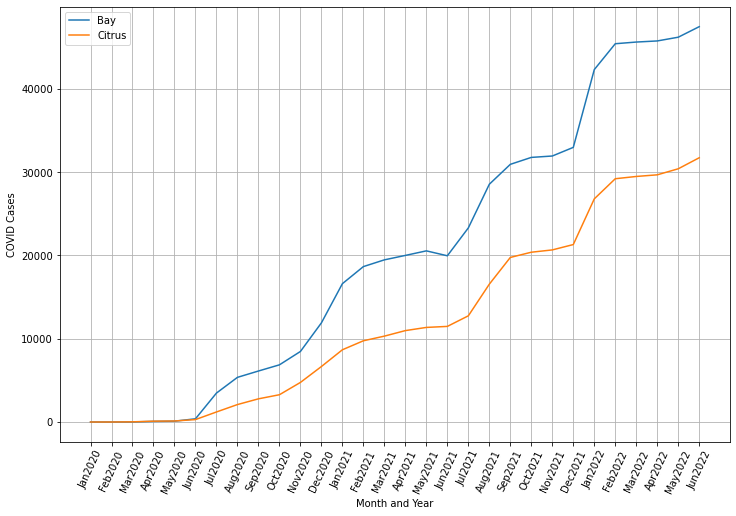

In [30]:
plt.figure(figsize=(12,8))

plt.plot(new_flo[['Bay County', 'Citrus County']])
plt.xticks(rotation=65)
plt.xlabel('Month and Year')
plt.ylabel('COVID Cases')
plt.legend(['Bay', 'Citrus'])
plt.grid(True)
plt.show()

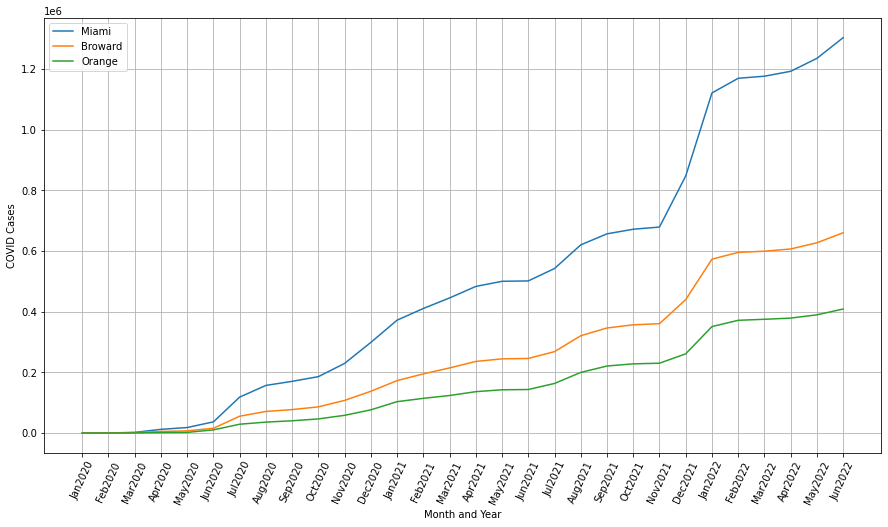

In [31]:
plt.figure(figsize=(15,8))


plt.plot(new_flo[['Miami-Dade County', 'Broward County', 'Orange County']])
plt.xticks(rotation=65)
plt.xlabel('Month and Year')

plt.ylabel('COVID Cases')
plt.legend(['Miami', 'Broward', 'Orange'])
plt.grid(True)
plt.show()

###### Restructure dataframe for time series map


In [32]:
map_df = florida_total.melt(id_vars=["County Name"],
                           var_name="Date",
                           value_name="Covid Cases")
                          

map_df.head()

,County Name,Date,Covid Cases
0,Alachua County,Jan2020,0
1,Baker County,Jan2020,0
2,Bay County,Jan2020,0
3,Bradford County,Jan2020,0
4,Brevard County,Jan2020,0


In [33]:
#start with list of months to set order
months = ["Jan2020", "Feb2020", "Mar2020", "Apr2020", "May2020", "Jun2020", 
          "Jul2020", "Aug2020", "Sep2020", "Oct2020", "Nov2020", "Dec2020", "Jan2021", "Feb2021", "Mar2021", "Apr2021", "May2021", "Jun2021", 
          "Jul2021", "Aug2021", "Sep2021", "Oct2021", "Nov2021", "Dec2021", "Jan2022", "Feb2022", "Mar2022", "Apr2022", "May2022", "Jun2022"]

#adds new column 'months', specify categories, pandas remembers order from 'months' list
map_df['months'] = pd.Categorical(map_df['Date'], categories=months, ordered=True)

#sorts df by new 'month' column which has order from list
map_df.sort_values(by='months',inplace=True)  

map_df.head()

,County Name,Date,Covid Cases,months
0,Alachua County,Jan2020,0,Jan2020
36,Levy County,Jan2020,0,Jan2020
37,Liberty County,Jan2020,0,Jan2020
38,Madison County,Jan2020,0,Jan2020
39,Manatee County,Jan2020,0,Jan2020


In [34]:
map_df2 = map_df.sort_values(['County Name', 'months'],
                            ascending= [True, True])
map_df2

,County Name,Date,Covid Cases,months
0,Alachua County,Jan2020,0,Jan2020
67,Alachua County,Feb2020,0,Feb2020
134,Alachua County,Mar2020,87,Mar2020
201,Alachua County,Apr2020,267,Apr2020
268,Alachua County,May2020,380,May2020
...,...,...,...,...
1741,Washington County,Feb2022,6580,Feb2022
1808,Washington County,Mar2022,6602,Mar2022
1875,Washington County,Apr2022,6632,Apr2022
1942,Washington County,May2022,6664,May2022


###### Geodata

In [35]:
county_gjson = gpd.read_file('uscountynew.geojson')

In [36]:
grouped_gj = county_gjson.sort_values('namelsad')
grouped_gj.reset_index(drop=True, inplace=True) #reset index to 0 
grouped_gj.rename(columns={'namelsad': 'County Name'}, inplace=True)
grouped_gj.head()

,intptlat,countyns,countyfp_nozero,stusab,state_name,csafp,aland,geoid,countyfp,County Name,...,classfp,lsad,funcstat,name,metdivfp,cbsafp,intptlon,statefp,mtfcc,geometry
0,+29.6757403,00308548,1,FL,Florida,264,2267634813,12001,001,Alachua County,...,H1,06,A,Alachua,None,23540,-082.3572210,12,G4020,"POLYGON ((-82.65704 29.72664, -82.65703 29.726..."
1,+30.3244416,00306920,3,FL,Florida,300,1515738968,12003,003,Baker County,...,H1,06,A,Baker,None,27260,-082.3022838,12,G4020,"POLYGON ((-82.10107 30.36279, -82.10101 30.362..."
2,+30.2382176,00295738,5,FL,Florida,None,1964743641,12005,005,Bay County,...,H1,06,A,Bay,None,37460,-085.6316798,12,G4020,"POLYGON ((-85.99565 30.28131, -85.99562 30.282..."
3,+29.9523863,00303634,7,FL,Florida,None,761362115,12007,007,Bradford County,...,H1,06,A,Bradford,None,None,-082.1666793,12,G4020,"POLYGON ((-82.27400 29.99832, -82.27398 29.998..."
4,+28.2983112,00295749,9,FL,Florida,None,2628793422,12009,009,Brevard County,...,H1,06,A,Brevard,None,37340,-080.7003334,12,G4020,"POLYGON ((-80.86158 28.24656, -80.86155 28.247..."


In [37]:
grouped_gj.drop(grouped_gj.columns.difference(['County Name','geometry']), 1, inplace=True)
grouped_gj.head()

C:\Users\jakea\AppData\Local\Temp\ipykernel_21828\2922497601.py:1: FutureWarning:

In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only



,County Name,geometry
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726..."
1,Baker County,"POLYGON ((-82.10107 30.36279, -82.10101 30.362..."
2,Bay County,"POLYGON ((-85.99565 30.28131, -85.99562 30.282..."
3,Bradford County,"POLYGON ((-82.27400 29.99832, -82.27398 29.998..."
4,Brevard County,"POLYGON ((-80.86158 28.24656, -80.86155 28.247..."


In [38]:
new_grouped_gj = grouped_gj.replace(r"^ +| +$", r"", regex=True) #checks for whitespace and removes if found 

In [39]:
new_map_df2 = map_df2.replace(r"^ +| +$", r"", regex=True)
new_map_df2.head()

,County Name,Date,Covid Cases,months
0,Alachua County,Jan2020,0,Jan2020
67,Alachua County,Feb2020,0,Feb2020
134,Alachua County,Mar2020,87,Mar2020
201,Alachua County,Apr2020,267,Apr2020
268,Alachua County,May2020,380,May2020


In [40]:
joined_gdf = new_grouped_gj.merge(new_map_df2, on='County Name') #data for time series map
joined_gdf.head(150)

,County Name,geometry,Date,Covid Cases,months
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2020,0,Jan2020
1,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Feb2020,0,Feb2020
2,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Mar2020,87,Mar2020
3,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Apr2020,267,Apr2020
4,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",May2020,380,May2020
...,...,...,...,...,...
145,Brevard County,"POLYGON ((-80.86158 28.24656, -80.86155 28.247...",Feb2022,132047,Feb2022
146,Brevard County,"POLYGON ((-80.86158 28.24656, -80.86155 28.247...",Mar2022,132955,Mar2022
147,Brevard County,"POLYGON ((-80.86158 28.24656, -80.86155 28.247...",Apr2022,134233,Apr2022
148,Brevard County,"POLYGON ((-80.86158 28.24656, -80.86155 28.247...",May2022,138165,May2022


In [41]:
joined_gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2010 entries, 0 to 2009
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   County Name  2010 non-null   object  
 1   geometry     2010 non-null   geometry
 2   Date         2010 non-null   object  
 3   Covid Cases  2010 non-null   int64   
 4   months       2010 non-null   category
dtypes: category(1), geometry(1), int64(1), object(2)
memory usage: 81.8+ KB


####  Preparing data for Leaflet map

In [42]:
data1 = florida_total.loc[:, florida_total.columns.intersection(['County Name','Jun2022'])] #trim df to county and Jun2022 -> total covid cases (cumulative)
data1.rename(columns = {'Jun2022':'Total_Covid'}, inplace = True) #renames Jun2022 to Total_Covid
data1

,County Name,Total_Covid
0,Alachua County,73353
1,Baker County,8890
2,Bay County,47484
3,Bradford County,7723
4,Brevard County,145889
...,...,...
62,Union County,4396
63,Volusia County,125956
64,Wakulla County,10298
65,Walton County,17101


In [43]:
data_gdf = gpd.read_file('two_map_geom.geojson')
data_gdf

,id,County Name,geometry
0,0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726..."
1,1,Baker County,"POLYGON ((-82.10107 30.36279, -82.10101 30.362..."
2,2,Bay County,"POLYGON ((-85.99565 30.28131, -85.99562 30.282..."
3,3,Bradford County,"POLYGON ((-82.27400 29.99832, -82.27398 29.998..."
4,4,Brevard County,"POLYGON ((-80.86158 28.24656, -80.86155 28.247..."
...,...,...,...
62,62,Union County,"POLYGON ((-82.28701 30.14173, -82.28700 30.141..."
63,63,Volusia County,"POLYGON ((-81.50280 29.10627, -81.50284 29.106..."
64,64,Wakulla County,"POLYGON ((-84.50434 30.30186, -84.50432 30.301..."
65,65,Walton County,"POLYGON ((-86.39160 30.72189, -86.39160 30.723..."


In [44]:
new_gdf = data_gdf.replace(r"^ +| +$", r"", regex=True) #checks for whitespace and removes if found 

In [45]:
new_data1 = data1.replace(r"^ +| +$", r"", regex=True) #checks for whitespace and removes if found 

In [46]:
final_df = new_gdf.merge(new_data1, on = "County Name")
pd.set_option("display.max_rows", None, "display.max_columns", None) #view full df
final_df = final_df.drop('id', axis=1)
final_df.head()

,County Name,geometry,Total_Covid
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",73353
1,Baker County,"POLYGON ((-82.10107 30.36279, -82.10101 30.362...",8890
2,Bay County,"POLYGON ((-85.99565 30.28131, -85.99562 30.282...",47484
3,Bradford County,"POLYGON ((-82.27400 29.99832, -82.27398 29.998...",7723
4,Brevard County,"POLYGON ((-80.86158 28.24656, -80.86155 28.247...",145889


#### converting to log10 

In [47]:
final_df['log_Confirmed'] = np.log10(final_df['Total_Covid'])
final_df.head()

,County Name,geometry,Total_Covid,log_Confirmed
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",73353,4.865418
1,Baker County,"POLYGON ((-82.10107 30.36279, -82.10101 30.362...",8890,3.948902
2,Bay County,"POLYGON ((-85.99565 30.28131, -85.99562 30.282...",47484,4.676547
3,Bradford County,"POLYGON ((-82.27400 29.99832, -82.27398 29.998...",7723,3.887786
4,Brevard County,"POLYGON ((-80.86158 28.24656, -80.86155 28.247...",145889,5.164023


In [48]:
final_df.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 67 entries, 0 to 66
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   County Name    67 non-null     object  
 1   geometry       67 non-null     geometry
 2   Total_Covid    67 non-null     int64   
 3   log_Confirmed  67 non-null     float64 
dtypes: float64(1), geometry(1), int64(1), object(1)
memory usage: 2.6+ KB


In [49]:
covid_totals = final_df.sort_values(by=['Total_Covid'])
covid_totals.head()

,County Name,geometry,Total_Covid,log_Confirmed
20,Glades County,"POLYGON ((-81.26734 27.06737, -81.26734 27.067...",2059,3.313656
37,Liberty County,"POLYGON ((-84.78179 30.51673, -84.78177 30.515...",2561,3.408410
32,Lafayette County,"POLYGON ((-83.36845 30.12867, -83.36845 30.128...",2822,3.450557
17,Franklin County,"POLYGON ((-84.76098 30.01149, -84.76090 30.011...",3160,3.499687
22,Hamilton County,"POLYGON ((-83.09647 30.43623, -83.09775 30.436...",3908,3.591955


In [50]:
covid_totals['% of Total'] = ((covid_totals['Total_Covid'] / covid_totals['Total_Covid'].sum())*100).round(2)
covid_totals.head()

,County Name,geometry,Total_Covid,log_Confirmed,% of Total
20,Glades County,"POLYGON ((-81.26734 27.06737, -81.26734 27.067...",2059,3.313656,0.03
37,Liberty County,"POLYGON ((-84.78179 30.51673, -84.78177 30.515...",2561,3.408410,0.04
32,Lafayette County,"POLYGON ((-83.36845 30.12867, -83.36845 30.128...",2822,3.450557,0.04
17,Franklin County,"POLYGON ((-84.76098 30.01149, -84.76090 30.011...",3160,3.499687,0.05
22,Hamilton County,"POLYGON ((-83.09647 30.43623, -83.09775 30.436...",3908,3.591955,0.06


In [51]:
covid_totals['Rank (1-Best, 67-Worst)'] = covid_totals.reset_index().index
covid_totals['Rank (1-Best, 67-Worst)'] = covid_totals['Rank (1-Best, 67-Worst)'] + 1

covid_totals.head()

,County Name,geometry,Total_Covid,log_Confirmed,% of Total,"Rank (1-Best, 67-Worst)"
20,Glades County,"POLYGON ((-81.26734 27.06737, -81.26734 27.067...",2059,3.313656,0.03,1
37,Liberty County,"POLYGON ((-84.78179 30.51673, -84.78177 30.515...",2561,3.408410,0.04,2
32,Lafayette County,"POLYGON ((-83.36845 30.12867, -83.36845 30.128...",2822,3.450557,0.04,3
17,Franklin County,"POLYGON ((-84.76098 30.01149, -84.76090 30.011...",3160,3.499687,0.05,4
22,Hamilton County,"POLYGON ((-83.09647 30.43623, -83.09775 30.436...",3908,3.591955,0.06,5


# Map creation

In [52]:
sample_map = folium.Map(
    location=[27.994402, -81.760254],
    tiles="cartodbpositron",
    min_zoom=6,
    zoom_start=6,
    max_bounds=True)

In [53]:
import branca

colormap = branca.colormap.linear.YlOrRd_09.scale(0, 1350000)
colormap = colormap.to_step(index=[2000, 5000, 10000, 50000, 100000, 200000, 1350000])
colormap.caption = 'Florida Covid Cases (ending June 2022)'
colormap.add_to(sample_map)

In [54]:
#bins = list(final_df["Total_Covid"].quantile([0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.99, 1]))

folium.Choropleth(
geo_data=final_df,
data=final_df,
columns=['County Name',"log_Confirmed"],
key_on="feature.properties.County Name",
bins=9,
fill_color='YlOrRd',
fill_opacity=1,
line_opacity=0.2,
legend_name="Log of number of confirmed Covid cases, Florida",
smooth_factor=0,
Highlight= True,
line_color = "#0000",
name = "Covid",
show=False,
overlay=True,
nan_fill_color = "White"
).add_to(sample_map)

# Add hover functionality.
style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}
NIL = folium.features.GeoJson(
    data = final_df,
    style_function=style_function, 
    control=False,
    highlight_function=highlight_function, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['County Name','log_Confirmed','Total_Covid'],
        aliases=['County Name','log_Confirmed','Total Covid Cases:'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
sample_map.add_child(NIL)
sample_map.keep_in_front(NIL)

sample_map

TO DO: 

https://www.jumpingrivers.com/blog/interactive-maps-python-covid-19-spread/ - time series link

Add natural disaster data to geodataframe

Add points to map for each county hit by natural disaster (make new column, add coords, add point) 

https://support.minitab.com/en-us/minitab/19/help-and-how-to/calculations-data-generation-and-matrices/calculator/calculator-functions/logarithm-calculator-functions/log-base-10-function/#:~:text=In%20statistics%2C%20log%20base%2010,To%20stabilize%20variation%20within%20groups

#### Creating new df for date

In [55]:
dates = {'months': ['Jan2020', 'Feb2020','Mar2020','Apr2020','May2020','Jun2020','Jul2020','Aug2020','Sep2020','Oct2020','Nov2020','Dec2020', 'Jan2021', 'Feb2021','Mar2021','Apr2021','May2021','Jun2021','Jul2021','Aug2021','Sep2021','Oct2021','Nov2021','Dec2021','Jan2022', 'Feb2022','Mar2022','Apr2022','May2022','Jun2022'],
         'date': ["31/01/2020", "28/02/2020", '31/03/2020','30/04/2020','31/05/2020','30/06/2020','31/07/2020','31/08/2020','30/09/2020','31/10/2020','30/11/2020','31/12/2020', "31/01/2021", "28/02/2021", '31/03/2021','30/04/2021','31/05/2021','30/06/2021','31/07/2021','31/08/2021','30/09/2021','31/10/2021','30/11/2021','31/12/2021',"31/01/2022", "28/02/2022", '31/03/2022','30/04/2022','31/05/2022','30/06/2022']}

date_df = pd.DataFrame(dates) #adding date in proper format
date_df

,months,date
0,Jan2020,31/01/2020
1,Feb2020,28/02/2020
2,Mar2020,31/03/2020
3,Apr2020,30/04/2020
4,May2020,31/05/2020
5,Jun2020,30/06/2020
6,Jul2020,31/07/2020
7,Aug2020,31/08/2020
8,Sep2020,30/09/2020
9,Oct2020,31/10/2020


In [56]:
date_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30 entries, 0 to 29
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   months  30 non-null     object
 1   date    30 non-null     object
dtypes: object(2)
memory usage: 608.0+ bytes


In [57]:
date_df['date1'] = pd.to_datetime(date_df['date'])
date_df.drop('date', axis=1, inplace=True)
date_df

,months,date1
0,Jan2020,2020-01-31
1,Feb2020,2020-02-28
2,Mar2020,2020-03-31
3,Apr2020,2020-04-30
4,May2020,2020-05-31
5,Jun2020,2020-06-30
6,Jul2020,2020-07-31
7,Aug2020,2020-08-31
8,Sep2020,2020-09-30
9,Oct2020,2020-10-31


In [58]:
new_date = joined_gdf.merge(date_df, on = "months")
new_date.head()

,County Name,geometry,Date,Covid Cases,months,date1
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2020,0,Jan2020,2020-01-31
1,Baker County,"POLYGON ((-82.10107 30.36279, -82.10101 30.362...",Jan2020,0,Jan2020,2020-01-31
2,Bay County,"POLYGON ((-85.99565 30.28131, -85.99562 30.282...",Jan2020,0,Jan2020,2020-01-31
3,Bradford County,"POLYGON ((-82.27400 29.99832, -82.27398 29.998...",Jan2020,0,Jan2020,2020-01-31
4,Brevard County,"POLYGON ((-80.86158 28.24656, -80.86155 28.247...",Jan2020,0,Jan2020,2020-01-31


In [59]:
new_date = new_date.sort_values(['County Name', 'date1'],
                            ascending= [True, True])
new_date.head()

,County Name,geometry,Date,Covid Cases,months,date1
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2020,0,Jan2020,2020-01-31
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Feb2020,0,Feb2020,2020-02-28
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Mar2020,87,Mar2020,2020-03-31
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Apr2020,267,Apr2020,2020-04-30
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",May2020,380,May2020,2020-05-31


In [60]:
new_date['Log_covid'] = new_date['Covid Cases']
new_date.head()

,County Name,geometry,Date,Covid Cases,months,date1,Log_covid
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2020,0,Jan2020,2020-01-31,0
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Feb2020,0,Feb2020,2020-02-28,0
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Mar2020,87,Mar2020,2020-03-31,87
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Apr2020,267,Apr2020,2020-04-30,267
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",May2020,380,May2020,2020-05-31,380


In [61]:
new_date.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2010 entries, 0 to 2009
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   County Name  2010 non-null   object        
 1   geometry     2010 non-null   geometry      
 2   Date         2010 non-null   object        
 3   Covid Cases  2010 non-null   int64         
 4   months       2010 non-null   object        
 5   date1        2010 non-null   datetime64[ns]
 6   Log_covid    2010 non-null   int64         
dtypes: datetime64[ns](1), geometry(1), int64(2), object(3)
memory usage: 125.6+ KB


In [62]:
new_date['Log_covid'] = new_date['Log_covid'].astype(str)
new_date.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2010 entries, 0 to 2009
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   County Name  2010 non-null   object        
 1   geometry     2010 non-null   geometry      
 2   Date         2010 non-null   object        
 3   Covid Cases  2010 non-null   int64         
 4   months       2010 non-null   object        
 5   date1        2010 non-null   datetime64[ns]
 6   Log_covid    2010 non-null   object        
dtypes: datetime64[ns](1), geometry(1), int64(1), object(4)
memory usage: 125.6+ KB


In [63]:
new_date['Log_covid'] = new_date['Log_covid'].replace(['0'],'1')
new_date.head()

,County Name,geometry,Date,Covid Cases,months,date1,Log_covid
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2020,0,Jan2020,2020-01-31,1
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Feb2020,0,Feb2020,2020-02-28,1
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Mar2020,87,Mar2020,2020-03-31,87
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Apr2020,267,Apr2020,2020-04-30,267
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",May2020,380,May2020,2020-05-31,380


In [64]:
new_date['Log_covid'] = new_date['Log_covid'].astype(int)

In [65]:
new_date['log_Confirmed'] = np.log10(new_date['Log_covid'])
new_date.head()

,County Name,geometry,Date,Covid Cases,months,date1,Log_covid,log_Confirmed
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2020,0,Jan2020,2020-01-31,1,0.000000
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Feb2020,0,Feb2020,2020-02-28,1,0.000000
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Mar2020,87,Mar2020,2020-03-31,87,1.939519
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Apr2020,267,Apr2020,2020-04-30,267,2.426511
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",May2020,380,May2020,2020-05-31,380,2.579784


In [66]:
#create new column 'daily' which subtracts value above, grouped by county

new_date['daily'] = new_date['Covid Cases'] - new_date.groupby('County Name')['Covid Cases'].shift()
new_date.head()

,County Name,geometry,Date,Covid Cases,months,date1,Log_covid,log_Confirmed,daily
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2020,0,Jan2020,2020-01-31,1,0.000000,NaN
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Feb2020,0,Feb2020,2020-02-28,1,0.000000,0.0
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Mar2020,87,Mar2020,2020-03-31,87,1.939519,87.0
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Apr2020,267,Apr2020,2020-04-30,267,2.426511,180.0
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",May2020,380,May2020,2020-05-31,380,2.579784,113.0


In [67]:
new_date.fillna(0, inplace=True)
new_date.head()

,County Name,geometry,Date,Covid Cases,months,date1,Log_covid,log_Confirmed,daily
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2020,0,Jan2020,2020-01-31,1,0.000000,0.0
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Feb2020,0,Feb2020,2020-02-28,1,0.000000,0.0
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Mar2020,87,Mar2020,2020-03-31,87,1.939519,87.0
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Apr2020,267,Apr2020,2020-04-30,267,2.426511,180.0
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",May2020,380,May2020,2020-05-31,380,2.579784,113.0


In [68]:
#new_date.daily = new_date.daily.str.replace(',', '').astype(float).astype(int)

In [69]:
#new_date['daily'] = new_date['daily'].astype(str)
new_date.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2010 entries, 0 to 2009
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   County Name    2010 non-null   object        
 1   geometry       2010 non-null   geometry      
 2   Date           2010 non-null   object        
 3   Covid Cases    2010 non-null   int64         
 4   months         2010 non-null   object        
 5   date1          2010 non-null   datetime64[ns]
 6   Log_covid      2010 non-null   int32         
 7   log_Confirmed  2010 non-null   float64       
 8   daily          2010 non-null   float64       
dtypes: datetime64[ns](1), float64(2), geometry(1), int32(1), int64(1), object(3)
memory usage: 149.2+ KB


In [70]:

new_date.head()

,County Name,geometry,Date,Covid Cases,months,date1,Log_covid,log_Confirmed,daily
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2020,0,Jan2020,2020-01-31,1,0.000000,0.0
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Feb2020,0,Feb2020,2020-02-28,1,0.000000,0.0
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Mar2020,87,Mar2020,2020-03-31,87,1.939519,87.0
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Apr2020,267,Apr2020,2020-04-30,267,2.426511,180.0
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",May2020,380,May2020,2020-05-31,380,2.579784,113.0


In [71]:
new_date.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2010 entries, 0 to 2009
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   County Name    2010 non-null   object        
 1   geometry       2010 non-null   geometry      
 2   Date           2010 non-null   object        
 3   Covid Cases    2010 non-null   int64         
 4   months         2010 non-null   object        
 5   date1          2010 non-null   datetime64[ns]
 6   Log_covid      2010 non-null   int32         
 7   log_Confirmed  2010 non-null   float64       
 8   daily          2010 non-null   float64       
dtypes: datetime64[ns](1), float64(2), geometry(1), int32(1), int64(1), object(3)
memory usage: 149.2+ KB


In [72]:
new_date['daily'] = new_date['daily'].apply(np.int64)

In [73]:
new_date.isnull().sum().sum()

0

In [74]:
new_date["daily"] = pd.to_numeric(new_date["daily"])
new_date.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2010 entries, 0 to 2009
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   County Name    2010 non-null   object        
 1   geometry       2010 non-null   geometry      
 2   Date           2010 non-null   object        
 3   Covid Cases    2010 non-null   int64         
 4   months         2010 non-null   object        
 5   date1          2010 non-null   datetime64[ns]
 6   Log_covid      2010 non-null   int32         
 7   log_Confirmed  2010 non-null   float64       
 8   daily          2010 non-null   int64         
dtypes: datetime64[ns](1), float64(1), geometry(1), int32(1), int64(2), object(3)
memory usage: 149.2+ KB


In [75]:
new_date['daily'] = new_date['daily'].astype(str)
new_date.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2010 entries, 0 to 2009
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   County Name    2010 non-null   object        
 1   geometry       2010 non-null   geometry      
 2   Date           2010 non-null   object        
 3   Covid Cases    2010 non-null   int64         
 4   months         2010 non-null   object        
 5   date1          2010 non-null   datetime64[ns]
 6   Log_covid      2010 non-null   int32         
 7   log_Confirmed  2010 non-null   float64       
 8   daily          2010 non-null   object        
dtypes: datetime64[ns](1), float64(1), geometry(1), int32(1), int64(1), object(4)
memory usage: 149.2+ KB


In [76]:
new_date['daily'] = new_date['daily'].replace(['0'],'1')
new_date.head()

,County Name,geometry,Date,Covid Cases,months,date1,Log_covid,log_Confirmed,daily
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2020,0,Jan2020,2020-01-31,1,0.000000,1
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Feb2020,0,Feb2020,2020-02-28,1,0.000000,1
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Mar2020,87,Mar2020,2020-03-31,87,1.939519,87
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Apr2020,267,Apr2020,2020-04-30,267,2.426511,180
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",May2020,380,May2020,2020-05-31,380,2.579784,113


In [77]:
new_date['daily'] = new_date['daily'].astype(int)
new_date.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2010 entries, 0 to 2009
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   County Name    2010 non-null   object        
 1   geometry       2010 non-null   geometry      
 2   Date           2010 non-null   object        
 3   Covid Cases    2010 non-null   int64         
 4   months         2010 non-null   object        
 5   date1          2010 non-null   datetime64[ns]
 6   Log_covid      2010 non-null   int32         
 7   log_Confirmed  2010 non-null   float64       
 8   daily          2010 non-null   int32         
dtypes: datetime64[ns](1), float64(1), geometry(1), int32(2), int64(1), object(3)
memory usage: 141.3+ KB


In [78]:
new_date['log_daily'] = np.log10(new_date['daily'])
new_date.head(50)

C:\Users\jakea\miniconda3\envs\gds\lib\site-packages\pandas\core\arraylike.py:364: RuntimeWarning:

invalid value encountered in log10



,County Name,geometry,Date,Covid Cases,months,date1,Log_covid,log_Confirmed,daily,log_daily
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2020,0,Jan2020,2020-01-31,1,0.000000,1,0.000000
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Feb2020,0,Feb2020,2020-02-28,1,0.000000,1,0.000000
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Mar2020,87,Mar2020,2020-03-31,87,1.939519,87,1.939519
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Apr2020,267,Apr2020,2020-04-30,267,2.426511,180,2.255273
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",May2020,380,May2020,2020-05-31,380,2.579784,113,2.053078
335,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jun2020,1197,Jun2020,2020-06-30,1197,3.078094,817,2.912222
402,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jul2020,3526,Jul2020,2020-07-31,3526,3.547282,2329,3.367169
469,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Aug2020,5196,Aug2020,2020-08-31,5196,3.715669,1670,3.222716
536,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Sep2020,8293,Sep2020,2020-09-30,8293,3.918712,3097,3.490941
603,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Oct2020,10582,Oct2020,2020-10-31,10582,4.024568,2289,3.359646


In [79]:
new_date.isnull().sum().sum()

20

#### finding highest values for new monthly cases

In [80]:
#lists counties highest value 
new_date1 = new_date.groupby(['County Name'], sort=False)['daily'].max()
new_date1

County Name
Alachua County          18842
Baker County             1790
Bay County               9342
Bradford County          1378
Brevard County          33834
Broward County         133337
Calhoun County            736
Charlotte County         7291
Citrus County            5487
Clay County             13113
Collier County          16462
Columbia County          4101
DeSoto County            1613
Dixie County              645
Duval County            59104
Escambia County         15811
Flagler County           5123
Franklin County           591
Gadsden County           2916
Gilchrist County          824
Glades County             367
Gulf County               887
Hamilton County           762
Hardee County            1799
Hendry County            2681
Hernando County          8572
Highlands County         4867
Hillsborough County     78274
Holmes County            1133
Indian River County      6850
Jackson County           3105
Jefferson County          959
Lafayette County         110

In [81]:
#finding worst month for new monthly cases
idx = new_date.groupby(['County Name'])['daily'].transform(max) == new_date['daily']
new_date[idx]
#most are Jan2022, next cell removes jan2022

,County Name,geometry,Date,Covid Cases,months,date1,Log_covid,log_Confirmed,daily,log_daily
1608,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2022,62121,Jan2022,2022-01-31,62121,4.793238,18842,4.275127
1609,Baker County,"POLYGON ((-82.10107 30.36279, -82.10101 30.362...",Jan2022,7942,Jan2022,2022-01-31,7942,3.899930,1790,3.252853
1610,Bay County,"POLYGON ((-85.99565 30.28131, -85.99562 30.282...",Jan2022,42327,Jan2022,2022-01-31,42327,4.626617,9342,3.970440
1611,Bradford County,"POLYGON ((-82.27400 29.99832, -82.27398 29.998...",Jan2022,6868,Jan2022,2022-01-31,6868,3.836830,1378,3.139249
1612,Brevard County,"POLYGON ((-80.86158 28.24656, -80.86155 28.247...",Jan2022,122479,Jan2022,2022-01-31,122479,5.088062,33834,4.529353
1613,Broward County,"POLYGON ((-80.29699 26.33436, -80.29693 26.334...",Jan2022,573312,Jan2022,2022-01-31,573312,5.758391,133337,5.124951
1614,Calhoun County,"POLYGON ((-85.17189 30.56434, -85.17191 30.564...",Jan2022,3824,Jan2022,2022-01-31,3824,3.582518,736,2.866878
1615,Charlotte County,"POLYGON ((-82.25530 27.00034, -82.25530 27.000...",Jan2022,32068,Jan2022,2022-01-31,32068,4.506072,7291,3.862787
1616,Citrus County,"POLYGON ((-82.45142 28.69481, -82.45247 28.694...",Jan2022,26800,Jan2022,2022-01-31,26800,4.428135,5487,3.739335
1617,Clay County,"POLYGON ((-81.79823 30.18900, -81.79273 30.189...",Jan2022,48940,Jan2022,2022-01-31,48940,4.689664,13113,4.117702


In [82]:
#removes jan2022, now shows worst month for monthly cases
new_date2 = new_date[~new_date['Date'].astype(str).str.contains('Jan2022')]
new_date2 = new_date2.drop(['geometry', 'Covid Cases', 'months', 'date1', 'Log_covid', 'log_Confirmed', 'log_daily'], axis=1)
new_date2.nlargest(23, 'daily')

,County Name,Date,daily
1583,Miami-Dade County,Dec2021,168546
444,Miami-Dade County,Jul2020,81642
1546,Broward County,Dec2021,79466
1315,Miami-Dade County,Aug2021,78018
846,Miami-Dade County,Jan2021,73247
779,Miami-Dade County,Dec2020,69255
1985,Miami-Dade County,Jun2022,68273
1278,Broward County,Aug2021,52439
1717,Miami-Dade County,Feb2022,48296
712,Miami-Dade County,Nov2020,43727


In [83]:
# groups by county, then shows two highest month totals
new_date2.loc[new_date2.groupby('County Name')['daily'].nlargest(2).index.get_level_values(1)]

,County Name,Date,daily
1273,Alachua County,Aug2021,6085
1675,Alachua County,Feb2022,4953
1274,Baker County,Aug2021,1039
470,Baker County,Aug2020,797
1275,Bay County,Aug2021,5244
806,Bay County,Jan2021,4708
1276,Bradford County,Aug2021,990
740,Bradford County,Dec2020,768
1277,Brevard County,Aug2021,17308
1344,Brevard County,Sep2021,9646


#### Graphing monthly cases

In [84]:
graph_flo = new_date.drop(['geometry', 'Covid Cases', 'Date', 'months', 'Log_covid', 'log_Confirmed', 'log_daily'], axis=1)

graph_flo = graph_flo.pivot(index='date1', columns='County Name', values='daily')
#graph_flo.columns.name = None



graph_flo.head()


County Name,Alachua County,Baker County,Bay County,Bradford County,Brevard County,Broward County,Calhoun County,Charlotte County,Citrus County,Clay County,Collier County,Columbia County,DeSoto County,Dixie County,Duval County,Escambia County,Flagler County,Franklin County,Gadsden County,Gilchrist County,Glades County,Gulf County,Hamilton County,Hardee County,Hendry County,Hernando County,Highlands County,Hillsborough County,Holmes County,Indian River County,Jackson County,Jefferson County,Lafayette County,Lake County,Lee County,Leon County,Levy County,Liberty County,Madison County,Manatee County,Marion County,Martin County,Miami-Dade County,Monroe County,Nassau County,Okaloosa County,Okeechobee County,Orange County,Osceola County,Palm Beach County,Pasco County,Pinellas County,Polk County,Putnam County,Santa Rosa County,Sarasota County,Seminole County,St. Johns County,St. Lucie County,Sumter County,Suwannee County,Taylor County,Union County,Volusia County,Wakulla County,Walton County,Washington County
date1,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-01-31,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
2020-02-28,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
2020-03-31,87,9,8,2,37,1219,1,24,19,41,146,3,7,1,207,94,18,1,1,1,3,1,1,1,4,24,17,305,1,33,2,1,1,66,206,26,2,1,1,53,25,28,2123,27,10,39,1,373,110,551,40,167,73,13,44,76,103,79,38,51,3,1,1,80,1,18,1
2020-04-30,180,11,64,44,248,3734,7,212,80,232,450,55,22,7,805,412,115,2,94,5,3,1,6,18,79,66,64,819,9,57,12,28,1,161,815,193,17,3,55,527,150,163,9940,52,46,115,11,1012,368,2412,209,562,410,93,110,276,276,129,209,130,127,3,3,372,22,20,11
2020-05-31,113,9,26,5,137,2170,53,222,22,109,943,86,153,44,632,309,56,1,178,7,24,1,227,81,332,25,48,1077,9,40,237,1,7,74,887,185,13,210,14,465,73,460,5937,29,20,69,72,617,223,3033,137,568,544,46,91,283,111,52,224,72,37,19,28,284,11,79,45


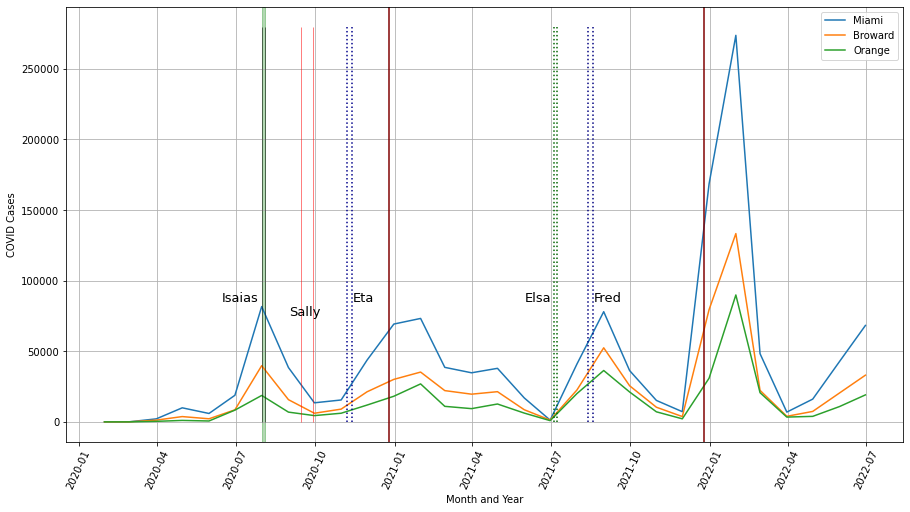

In [85]:
plt.figure(figsize=(15,8))

style = dict(size=13, color='black')

plt.plot(graph_flo[['Miami-Dade County', 'Broward County', 'Orange County']])
plt.xticks(rotation=65)
plt.xlabel('Month and Year')
plt.ylabel('COVID Cases')

#add text labels of natural disasters
plt.text('2020-06-15', 85000, "Isaias", **style)
plt.text('2020-09', 75000, "Sally", **style)
plt.text('2020-11-14', 85000, "Eta", **style)
plt.text('2021-06', 85000, "Elsa", **style)
plt.text('2021-08-20', 85000, "Fred", **style)

#add lines representing natural disaster start and end date
plt.vlines(x=['2020-07-31', '2020-08-04'], ymin=[0, 0], ymax=[280000, 280000], colors='black', ls='solid', lw=0.5)
plt.vlines(x=['2020-09-14', '2020-09-28'], ymin=[0, 0], ymax=[280000, 280000], colors='red', ls='solid', lw=0.5)
plt.vlines(x=['2020-11-07', '2020-11-12'], ymin=[0, 0], ymax=[280000, 280000], colors='darkblue', ls=':', lw=1.5)
plt.vlines(x=['2021-07-04', '2021-07-08'], ymin=[0, 0], ymax=[280000, 280000], colors='darkgreen', ls=':', lw=1.5)
plt.vlines(x=['2021-08-13', '2021-08-19'], ymin=[0, 0], ymax=[280000, 280000], colors='navy', ls=':', lw=1.5)

#fills between two lines
plt.axvspan('2020-07-31', '2020-08-04', alpha=.3, color='green')

#christmas
plt.axvline(x='2020-12-25', color='maroon')
plt.axvline(x='2021-12-25', color='maroon')


plt.legend(['Miami', 'Broward', 'Orange'])
plt.grid(True)
plt.show()

In [86]:
### add 

In [87]:
new_date.head()

,County Name,geometry,Date,Covid Cases,months,date1,Log_covid,log_Confirmed,daily,log_daily
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2020,0,Jan2020,2020-01-31,1,0.000000,1,0.000000
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Feb2020,0,Feb2020,2020-02-28,1,0.000000,1,0.000000
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Mar2020,87,Mar2020,2020-03-31,87,1.939519,87,1.939519
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Apr2020,267,Apr2020,2020-04-30,267,2.426511,180,2.255273
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",May2020,380,May2020,2020-05-31,380,2.579784,113,2.053078


In [88]:
final_log_date2 = new_date[['County Name', 'geometry', 'date1', 'log_daily']]
final_log_date2['log_daily'] = final_log_date2['log_daily'].fillna(-1)
final_log_date2.head(50)

C:\Users\jakea\miniconda3\envs\gds\lib\site-packages\geopandas\geodataframe.py:1322: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,County Name,geometry,date1,log_daily
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-01-31,0.000000
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-02-28,0.000000
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-03-31,1.939519
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-04-30,2.255273
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-05-31,2.053078
335,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-06-30,2.912222
402,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-07-31,3.367169
469,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-08-31,3.222716
536,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-09-30,3.490941
603,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-10-31,3.359646


In [89]:
final_log_date2.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2010 entries, 0 to 2009
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   County Name  2010 non-null   object        
 1   geometry     2010 non-null   geometry      
 2   date1        2010 non-null   datetime64[ns]
 3   log_daily    2010 non-null   float64       
dtypes: datetime64[ns](1), float64(1), geometry(1), object(1)
memory usage: 78.5+ KB


In [90]:
final_log_date2.isnull().sum().sum()

0

In [91]:
nan_rows = new_date[new_date['log_daily'].isnull()]
nan_rows.head(21)

,County Name,geometry,Date,Covid Cases,months,date1,Log_covid,log_Confirmed,daily,log_daily
1139,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jun2021,25425,Jun2021,2021-06-30,25425,4.405261,-14,NaN
1141,Bay County,"POLYGON ((-85.99565 30.28131, -85.99562 30.282...",Jun2021,19965,Jun2021,2021-06-30,19965,4.300269,-590,NaN
1149,Collier County,"POLYGON ((-81.80620 25.95355, -81.80622 25.953...",Jun2021,36319,Jun2021,2021-06-30,36319,4.560134,-690,NaN
1154,Escambia County,"POLYGON ((-87.44034 30.69035, -87.44038 30.690...",Jun2021,33139,Jun2021,2021-06-30,33139,4.520339,-3451,NaN
1156,Franklin County,"POLYGON ((-84.76098 30.01149, -84.76090 30.011...",Jun2021,1333,Jun2021,2021-06-30,1333,3.124830,-25,NaN
1161,Hamilton County,"POLYGON ((-83.09647 30.43623, -83.09775 30.436...",Jun2021,1634,Jun2021,2021-06-30,1634,3.213252,-7,NaN
1167,Holmes County,"POLYGON ((-85.83112 30.99412, -85.83096 30.994...",Jun2021,2277,Jun2021,2021-06-30,2277,3.357363,-2,NaN
1170,Jefferson County,"POLYGON ((-84.04119 30.48397, -84.04119 30.484...",Jun2021,1504,Jun2021,2021-06-30,1504,3.177248,-16,NaN
1173,Lee County,"POLYGON ((-81.80553 26.76975, -81.80423 26.769...",Jun2021,72609,Jun2021,2021-06-30,72609,4.860990,-853,NaN
1174,Leon County,"POLYGON ((-84.39741 30.48501, -84.39745 30.485...",Jun2021,32289,Jun2021,2021-06-30,32289,4.509055,-508,NaN


In [92]:
final_log_date = new_date[['County Name', 'geometry', 'date1', 'log_Confirmed']]
final_log_date.head()

,County Name,geometry,date1,log_Confirmed
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-01-31,0.000000
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-02-28,0.000000
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-03-31,1.939519
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-04-30,2.426511
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-05-31,2.579784


#convert date1 to mm/dd/yyyy

# https://www.jumpingrivers.com/blog/interactive-maps-python-covid-19-spread/

In [93]:
final_log_date2['date_sec'] = pd.to_datetime(final_log_date2['date1']).astype(np.int64) / 10**9 #change
final_log_date2['date_sec'] = final_log_date2['date_sec'].astype(int).astype(str)
final_log_date2.head()

C:\Users\jakea\AppData\Local\Temp\ipykernel_21828\4225404262.py:1: FutureWarning:

casting datetime64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.

C:\Users\jakea\miniconda3\envs\gds\lib\site-packages\geopandas\geodataframe.py:1322: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,County Name,geometry,date1,log_daily,date_sec
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-01-31,0.000000,1580428800
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-02-28,0.000000,1582848000
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-03-31,1.939519,1585612800
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-04-30,2.255273,1588204800
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2020-05-31,2.053078,1590883200


In [94]:
final_log_date2 = final_log_date2[['County Name', 'geometry', 'log_daily', 'date_sec']] #change log for new value
final_log_date2.head()

,County Name,geometry,log_daily,date_sec
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",0.000000,1580428800
67,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",0.000000,1582848000
134,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",1.939519,1585612800
201,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2.255273,1588204800
268,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",2.053078,1590883200


#### Disaster data

In [95]:
dis_df = pd.read_csv('dis_df.csv')
dis_df.head(20)

,Unnamed: 0,femaDeclarationString,disasterNumber,state,declarationType,Year,declarationDate,incidentType,declarationTitle,ihProgramDeclared,iaProgramDeclared,paProgramDeclared,hmProgramDeclared,incidentBeginDate,incidentEndDate,designatedArea
0,47467,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Brevard (County)
1,47468,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Broward (County)
2,47469,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Clay (County)
3,47470,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Duval (County)
4,47471,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Flagler (County)
5,47472,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Indian River (County)
6,47473,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Martin (County)
7,47474,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Miami-Dade (County)
8,47475,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Orange (County)
9,47476,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,St. Lucie (County)


In [96]:
disaster = dis_df.drop(['Unnamed: 0', 'femaDeclarationString', 'disasterNumber', 'state', 'declarationType', 'declarationDate', 'ihProgramDeclared', 'iaProgramDeclared', 'paProgramDeclared', 'hmProgramDeclared'], axis=1)
disaster.head()

,Year,incidentType,declarationTitle,incidentBeginDate,incidentEndDate,designatedArea
0,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Brevard (County)
1,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Broward (County)
2,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Clay (County)
3,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Duval (County)
4,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Flagler (County)


In [97]:
disaster = disaster.drop_duplicates(subset=None, keep="first", inplace=False)
disaster.head()

,Year,incidentType,declarationTitle,incidentBeginDate,incidentEndDate,designatedArea
0,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Brevard (County)
1,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Broward (County)
2,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Clay (County)
3,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Duval (County)
4,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Flagler (County)


In [98]:
disaster['designatedArea']=disaster['designatedArea'].str.replace('(County)','')
disaster['designatedArea']=disaster['designatedArea'].str.replace('(','')
disaster['designatedArea']=disaster['designatedArea'].str.replace(')','')
disaster.head()

C:\Users\jakea\AppData\Local\Temp\ipykernel_21828\4122023970.py:1: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\jakea\AppData\Local\Temp\ipykernel_21828\4122023970.py:2: FutureWarning:

The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.

C:\Users\jakea\AppData\Local\Temp\ipykernel_21828\4122023970.py:3: FutureWarning:

The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.



,Year,incidentType,declarationTitle,incidentBeginDate,incidentEndDate,designatedArea
0,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Brevard
1,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Broward
2,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Clay
3,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Duval
4,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Flagler


In [99]:
disaster=disaster.rename(columns = {'designatedArea':'County'})
disaster.head()

,Year,incidentType,declarationTitle,incidentBeginDate,incidentEndDate,County
0,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Brevard
1,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Broward
2,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Clay
3,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Duval
4,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Flagler


In [100]:
disaster['index1'] = disaster.index

In [101]:
disaster.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 113 entries, 0 to 125
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Year               113 non-null    int64 
 1   incidentType       113 non-null    object
 2   declarationTitle   113 non-null    object
 3   incidentBeginDate  113 non-null    object
 4   incidentEndDate    110 non-null    object
 5   County             113 non-null    object
 6   index1             113 non-null    int64 
dtypes: int64(2), object(5)
memory usage: 7.1+ KB


In [102]:
disaster.tail()

,Year,incidentType,declarationTitle,incidentBeginDate,incidentEndDate,County,index1
121,2021,Hurricane,TROPICAL STORM FRED,2021-08-13T09:00:00.000Z,2021-08-19T23:59:00.000Z,Levy,121
122,2021,Hurricane,TROPICAL STORM FRED,2021-08-13T09:00:00.000Z,2021-08-19T23:59:00.000Z,Leon,122
123,2022,Fire,CHIPOLA FIRE COMPLEX,2022-03-04T23:11:00.000Z,NaN,Bay,123
124,2022,Fire,CHIPOLA FIRE COMPLEX,2022-03-04T23:11:00.000Z,NaN,Calhoun,124
125,2022,Fire,1707 ADKINS AVE FIRE,2022-03-04T12:00:01.000Z,NaN,Bay,125


In [103]:
print(len(disaster))

113


#### Florida Coords

In [104]:
coords = pd.read_csv("Florida_coords.csv")
coords.head()

,sort,State,FIPS,County,County Seat(s),Population (2010),Land area km2,Land area mi2,Water area km2,Water area mi2,Total area km2,Total area mi2,Latitude,Longitude
0,321,FL,12001,Alachua,Gainesville,"247,336","2,266.29",875.02,242.911,93.788,"2,509.20",968.808,+29.675740°,–82.357221°
1,322,FL,12003,Baker,Macclenny,"27,115","1,515.74",585.231,9.686,3.74,"1,525.43",588.971,+30.324442°,–82.302284°
2,323,FL,12005,Bay,Panama City,"168,852","1,964.40",758.459,711.453,274.694,"2,675.85","1,033.15",+30.237563°,–85.631348°
3,324,FL,12007,Bradford,Starke,"28,520",761.357,293.962,16.905,6.527,778.262,300.489,+29.946934°,–82.166796°
4,325,FL,12009,Brevard,Titusville,"543,376","2,630.56","1,015.66","1,402.04",541.331,"4,032.60","1,557.00",+28.298276°,–80.700384°


In [105]:
coords.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67 entries, 0 to 66
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   sort               67 non-null     int64 
 1   State              67 non-null     object
 2   FIPS               67 non-null     int64 
 3   County             67 non-null     object
 4   County Seat(s)     67 non-null     object
 5   Population (2010)  67 non-null     object
 6   Land area km2      67 non-null     object
 7   Land area mi2      67 non-null     object
 8   Water area km2     67 non-null     object
 9   Water area mi2     67 non-null     object
 10  Total area km2     67 non-null     object
 11  Total area mi2     67 non-null     object
 12  Latitude           67 non-null     object
 13  Longitude          67 non-null     object
dtypes: int64(2), object(12)
memory usage: 7.5+ KB


In [106]:
coords['Latitude']=coords['Latitude'].str.strip('+')
coords['Latitude']=coords['Latitude'].str.strip('°')
coords['Longitude']=coords['Longitude'].str.strip('°')
coords['Longitude']=coords['Longitude'].str.replace('–','-')
coords

,sort,State,FIPS,County,County Seat(s),Population (2010),Land area km2,Land area mi2,Water area km2,Water area mi2,Total area km2,Total area mi2,Latitude,Longitude
0,321,FL,12001,Alachua,Gainesville,"247,336","2,266.29",875.02,242.911,93.788,"2,509.20",968.808,29.675740,-82.357221
1,322,FL,12003,Baker,Macclenny,"27,115","1,515.74",585.231,9.686,3.74,"1,525.43",588.971,30.324442,-82.302284
2,323,FL,12005,Bay,Panama City,"168,852","1,964.40",758.459,711.453,274.694,"2,675.85","1,033.15",30.237563,-85.631348
3,324,FL,12007,Bradford,Starke,"28,520",761.357,293.962,16.905,6.527,778.262,300.489,29.946934,-82.166796
4,325,FL,12009,Brevard,Titusville,"543,376","2,630.56","1,015.66","1,402.04",541.331,"4,032.60","1,557.00",28.298276,-80.700384
5,326,FL,12011,Broward,Fort Lauderdale,"1,748,066","3,133.33","1,209.79",292.869,113.077,"3,426.20","1,322.86",26.193520,-80.476658
6,327,FL,12013,Calhoun,Blountstown,"14,625","1,469.39",567.334,18.075,6.979,"1,487.46",574.313,30.388801,-85.197916
7,328,FL,12015,Charlotte,Punta Gorda,"159,978","1,761.91",680.279,461.075,178.022,"2,222.99",858.301,26.868826,-81.940858
8,329,FL,12017,Citrus,Inverness,"141,236","1,506.59",581.696,496.236,191.598,"2,002.82",773.294,28.843628,-82.524796
9,330,FL,12019,Clay,Green Cove Springs,"190,865","1,565.29",604.36,101.496,39.188,"1,666.78",643.548,29.987116,-81.858147


In [107]:
new_coords = coords[['County','Latitude','Longitude']]
new_coords.head()

,County,Latitude,Longitude
0,Alachua,29.675740,-82.357221
1,Baker,30.324442,-82.302284
2,Bay,30.237563,-85.631348
3,Bradford,29.946934,-82.166796
4,Brevard,28.298276,-80.700384


In [108]:
new_coords.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67 entries, 0 to 66
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   County     67 non-null     object
 1   Latitude   67 non-null     object
 2   Longitude  67 non-null     object
dtypes: object(3)
memory usage: 1.7+ KB


In [109]:
covid_totals.head() #add population to covid totals for hover function

,County Name,geometry,Total_Covid,log_Confirmed,% of Total,"Rank (1-Best, 67-Worst)"
20,Glades County,"POLYGON ((-81.26734 27.06737, -81.26734 27.067...",2059,3.313656,0.03,1
37,Liberty County,"POLYGON ((-84.78179 30.51673, -84.78177 30.515...",2561,3.408410,0.04,2
32,Lafayette County,"POLYGON ((-83.36845 30.12867, -83.36845 30.128...",2822,3.450557,0.04,3
17,Franklin County,"POLYGON ((-84.76098 30.01149, -84.76090 30.011...",3160,3.499687,0.05,4
22,Hamilton County,"POLYGON ((-83.09647 30.43623, -83.09775 30.436...",3908,3.591955,0.06,5


In [110]:
pop = coords[['County', 'Population (2010)']]
pop = pop.rename(columns={'County': 'County Name'})
pop['County Name'] = pop['County Name'].astype(str) + ' County'
pop = pop.replace(r"^ +| +$", r"", regex=True)
pop.head()

,County Name,Population (2010)
0,Alachua County,"247,336"
1,Baker County,"27,115"
2,Bay County,"168,852"
3,Bradford County,"28,520"
4,Brevard County,"543,376"


In [111]:
covid_totals1 = covid_totals.merge(pop, on='County Name')
covid_totals1.head()

,County Name,geometry,Total_Covid,log_Confirmed,% of Total,"Rank (1-Best, 67-Worst)",Population (2010)
0,Glades County,"POLYGON ((-81.26734 27.06737, -81.26734 27.067...",2059,3.313656,0.03,1,"12,884"
1,Liberty County,"POLYGON ((-84.78179 30.51673, -84.78177 30.515...",2561,3.408410,0.04,2,"8,365"
2,Lafayette County,"POLYGON ((-83.36845 30.12867, -83.36845 30.128...",2822,3.450557,0.04,3,"8,870"
3,Franklin County,"POLYGON ((-84.76098 30.01149, -84.76090 30.011...",3160,3.499687,0.05,4,"11,549"
4,Hamilton County,"POLYGON ((-83.09647 30.43623, -83.09775 30.436...",3908,3.591955,0.06,5,"14,799"


In [112]:
total_rank = covid_totals1['% of Total'].sum()
print(total_rank)

99.96999999999998


#### Joining disaster and coords

In [113]:
new_coords = new_coords.replace(r"^ +| +$", r"", regex=True)
disaster = disaster.replace(r"^ +| +$", r"", regex=True)

In [114]:
latlong = disaster.merge(new_coords, on='County')

In [115]:
#latlong.index1 = latlong.index1.astype(float)

In [116]:
latlong.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 113 entries, 0 to 112
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Year               113 non-null    int64 
 1   incidentType       113 non-null    object
 2   declarationTitle   113 non-null    object
 3   incidentBeginDate  113 non-null    object
 4   incidentEndDate    110 non-null    object
 5   County             113 non-null    object
 6   index1             113 non-null    int64 
 7   Latitude           113 non-null    object
 8   Longitude          113 non-null    object
dtypes: int64(2), object(7)
memory usage: 8.8+ KB


In [117]:
latlong = latlong.replace(r"^ +| +$", r"", regex=True)

In [118]:
latlong=latlong.sort_values("County")
latlong=latlong[latlong["incidentType"].str.contains("Fire")==False]
latlong=latlong[latlong["incidentType"].str.contains("Other")==False]
latlong.head(127)

,Year,incidentType,declarationTitle,incidentBeginDate,incidentEndDate,County,index1,Latitude,Longitude
81,2021,Severe Storm(s),TROPICAL STORM ELSA,2021-07-04T00:01:00.000Z,2021-07-08T23:59:00.000Z,Alachua,78,29.675740,-82.357221
80,2020,Hurricane,HURRICANE ETA,2020-11-07T09:44:00.000Z,2020-11-12T23:59:00.000Z,Alachua,41,29.675740,-82.357221
109,2021,Severe Storm(s),TROPICAL STORM ELSA,2021-07-04T00:01:00.000Z,2021-07-08T23:59:00.000Z,Baker,93,30.324442,-82.302284
36,2021,Hurricane,TROPICAL STORM FRED,2021-08-13T09:00:00.000Z,2021-08-19T23:59:00.000Z,Bay,100,30.237563,-85.631348
35,2020,Hurricane,HURRICANE SALLY,2020-09-14T09:25:00.000Z,2020-09-28T23:59:00.000Z,Bay,23,30.237563,-85.631348
110,2021,Severe Storm(s),TROPICAL STORM ELSA,2021-07-04T00:01:00.000Z,2021-07-08T23:59:00.000Z,Bradford,95,29.946934,-82.166796
0,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Brevard,0,28.298276,-80.700384
1,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Broward,1,26.193520,-80.476658
41,2020,Hurricane,HURRICANE SALLY,2020-09-14T09:25:00.000Z,2020-09-28T23:59:00.000Z,Calhoun,25,30.388801,-85.197916
42,2021,Hurricane,TROPICAL STORM FRED,2021-08-13T09:00:00.000Z,2021-08-19T23:59:00.000Z,Calhoun,101,30.388801,-85.197916


In [119]:
hurr = latlong[latlong['incidentType'].str.contains('Hur')]
hurr.head()

,Year,incidentType,declarationTitle,incidentBeginDate,incidentEndDate,County,index1,Latitude,Longitude
80,2020,Hurricane,HURRICANE ETA,2020-11-07T09:44:00.000Z,2020-11-12T23:59:00.000Z,Alachua,41,29.675740,-82.357221
36,2021,Hurricane,TROPICAL STORM FRED,2021-08-13T09:00:00.000Z,2021-08-19T23:59:00.000Z,Bay,100,30.237563,-85.631348
35,2020,Hurricane,HURRICANE SALLY,2020-09-14T09:25:00.000Z,2020-09-28T23:59:00.000Z,Bay,23,30.237563,-85.631348
0,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Brevard,0,28.298276,-80.700384
1,2020,Hurricane,HURRICANE ISAIAS,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Broward,1,26.193520,-80.476658


In [120]:
ss = latlong[latlong['incidentType'].str.contains('Sev')]
ss.head()

,Year,incidentType,declarationTitle,incidentBeginDate,incidentEndDate,County,index1,Latitude,Longitude
81,2021,Severe Storm(s),TROPICAL STORM ELSA,2021-07-04T00:01:00.000Z,2021-07-08T23:59:00.000Z,Alachua,78,29.675740,-82.357221
109,2021,Severe Storm(s),TROPICAL STORM ELSA,2021-07-04T00:01:00.000Z,2021-07-08T23:59:00.000Z,Baker,93,30.324442,-82.302284
110,2021,Severe Storm(s),TROPICAL STORM ELSA,2021-07-04T00:01:00.000Z,2021-07-08T23:59:00.000Z,Bradford,95,29.946934,-82.166796
94,2021,Severe Storm(s),TROPICAL STORM ELSA,2021-07-04T00:01:00.000Z,2021-07-08T23:59:00.000Z,Charlotte,63,26.868826,-81.940858
76,2021,Severe Storm(s),TROPICAL STORM ELSA,2021-07-04T00:01:00.000Z,2021-07-08T23:59:00.000Z,Citrus,64,28.843628,-82.524796


In [121]:
hurr.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 69 entries, 80 to 34
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Year               69 non-null     int64 
 1   incidentType       69 non-null     object
 2   declarationTitle   69 non-null     object
 3   incidentBeginDate  69 non-null     object
 4   incidentEndDate    69 non-null     object
 5   County             69 non-null     object
 6   index1             69 non-null     int64 
 7   Latitude           69 non-null     object
 8   Longitude          69 non-null     object
dtypes: int64(2), object(7)
memory usage: 5.4+ KB


In [122]:
ss.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 37 entries, 81 to 107
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Year               37 non-null     int64 
 1   incidentType       37 non-null     object
 2   declarationTitle   37 non-null     object
 3   incidentBeginDate  37 non-null     object
 4   incidentEndDate    37 non-null     object
 5   County             37 non-null     object
 6   index1             37 non-null     int64 
 7   Latitude           37 non-null     object
 8   Longitude          37 non-null     object
dtypes: int64(2), object(7)
memory usage: 2.9+ KB


In [123]:
hurrno = hurr.groupby('declarationTitle')['County'].nunique()
print(hurrno)

declarationTitle
HURRICANE ETA          13
HURRICANE ISAIAS       19
HURRICANE SALLY        14
TROPICAL STORM FRED    23
Name: County, dtype: int64


In [124]:
ssno = ss.groupby('declarationTitle')['County'].nunique()
print(ssno)

declarationTitle
TROPICAL STORM ELSA    37
Name: County, dtype: int64


In [125]:
latlong.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 106 entries, 81 to 34
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Year               106 non-null    int64 
 1   incidentType       106 non-null    object
 2   declarationTitle   106 non-null    object
 3   incidentBeginDate  106 non-null    object
 4   incidentEndDate    106 non-null    object
 5   County             106 non-null    object
 6   index1             106 non-null    int64 
 7   Latitude           106 non-null    object
 8   Longitude          106 non-null    object
dtypes: int64(2), object(7)
memory usage: 8.3+ KB


#### Starting new map

In [126]:
mymap1 = folium.Map(tiles='cartodbpositron')
mymap1.save(outfile='infinite_scroll.html')

In [127]:
mymap_fix_boundary = folium.Map(min_zoom=2, max_bounds=True, tiles='cartodbpositron')
mymap_fix_boundary.save(outfile='fix_boundary.html')

In [128]:
#define a colour map in terms of the log of the number of confirmed cases #change (F_L_D2 to F_L_D / log_daily to confirmed)
max_colour = max(final_log_date2['log_daily'])
min_colour = min(final_log_date2['log_daily'])
cmap = cm.linear.YlOrRd_09.scale(min_colour, max_colour)
final_log_date2['colour'] = final_log_date2['log_daily'].map(cmap)

In [129]:
#construct style dictionary #change

country_list = final_log_date2['County Name'].unique().tolist()
country_idx = range(len(country_list))

style_dict = {}
for i in country_idx:
    country = country_list[i]
    result = final_log_date2[final_log_date2['County Name'] == country]
    inner_dict = {}
    for _, r in result.iterrows():
        inner_dict[r['date_sec']] = {'color': r['colour'], 'opacity': 0.7}
    style_dict[str(i)] = inner_dict

In [130]:
#make a dataframe containing the geometry for each county #change

countries_df = final_log_date2[['geometry']]
countries_gdf = gpd.GeoDataFrame(countries_df)
countries_gdf = countries_gdf.drop_duplicates().reset_index()

##### Grouping hurricane and severe storm points

#create a map
this_map = folium.Map(min_zoom=6, zoom_start=7, location=[27.994402, -81.760254], max_bounds=True,tiles='cartodbpositron')

fgH=folium.FeatureGroup(name='Hurricanes', show=False)
this_map.add_child(fgH)

fgSS=folium.FeatureGroup(name='Severe Storms', show=False)
this_map.add_child(fgSS)

marker_cluster_H = MarkerCluster().add_to(fgH)
marker_cluster_SS = MarkerCluster().add_to(fgSS)

for i in range(0, len(hurr)):
    folium.Marker([hurr.iloc[i]["Latitude"], hurr.iloc[i]["Longitude"]],
                 popup=hurr.iloc[i]["declarationTitle"],
                 icon=folium.Icon(color="red", icon="remove-sign")).add_to(marker_cluster_H)
    
for i in range(0, len(ss)):
    folium.Marker([ss.iloc[i]["Latitude"], ss.iloc[i]["Longitude"]],
                 popup=ss.iloc[i]["declarationTitle"]).add_to(marker_cluster_SS)

folium.LayerControl().add_to(this_map)

this_map

#create a map
this_map1 = folium.Map(location=[27.994402, -81.760254], prefer_canvas=True)

for i in range(0, len(ss)):
    folium.Marker([ss.iloc[i]["Latitude"], ss.iloc[i]["Longitude"]],
                 popup=ss.iloc[i]["declarationTitle"]).add_to(this_map1)

this_map1

In [131]:
from folium.plugins import TimeSliderChoropleth
from folium import plugins


slider_map = folium.Map(min_zoom=6, zoom_start=7, max_bounds=True, location=[27.994402, -81.760254], tiles=None, zoom_control=False)
folium.raster_layers.TileLayer(tiles='cartodbpositron', name='Carto Light', min_zoom=6, zoom_start=7, max_bounds=True).add_to(slider_map)
folium.raster_layers.TileLayer(tiles='cartodbdark_matter', name='Carto Dark', min_zoom=6, zoom_start=7, max_bounds=True).add_to(slider_map)

fgH=folium.FeatureGroup(name='Hurricanes', show=False)
slider_map.add_child(fgH)

fgSS=folium.FeatureGroup(name='Severe Storms', show=False)
slider_map.add_child(fgSS)

marker_cluster_H = MarkerCluster().add_to(fgH)
marker_cluster_SS = MarkerCluster().add_to(fgSS)



_ = TimeSliderChoropleth(
    data=countries_gdf.to_json(),
    styledict=style_dict,
    name="COVID",

).add_to(slider_map)

_ = cmap.add_to(slider_map)
cmap.caption = "Log of number of confirmed cases"


# Add hover functionality.
style_function1 = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function1 = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

NIL1 = folium.features.GeoJson(
    data = covid_totals1,
    style_function=style_function1, 
    control=False,
    highlight_function=highlight_function1, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['County Name','log_Confirmed','Total_Covid', '% of Total', 'Rank (1-Best, 67-Worst)', 'Population (2010)'],
        aliases=['County Name','log_Confirmed','Total Covid Cases:', '% of Total Cases:', 'Rank (1-Best, 67-Worst):', 'Population:'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
slider_map.add_child(NIL1)
slider_map.keep_in_front(NIL1)

for i in range(0, len(hurr)):
    folium.Marker([hurr.iloc[i]["Latitude"], hurr.iloc[i]["Longitude"]],
                 popup=hurr.iloc[i]["declarationTitle"],
                 icon=folium.Icon(color="red", icon="remove-sign")).add_to(marker_cluster_H)
    
for i in range(0, len(ss)):
    folium.Marker([ss.iloc[i]["Latitude"], ss.iloc[i]["Longitude"]],
                 popup=ss.iloc[i]["declarationTitle"]).add_to(marker_cluster_SS)

folium.LayerControl().add_to(slider_map)

plugins.Geocoder(position='topleft', add_marker=False, collapsed=True).add_to(slider_map)

slider_map.save(outfile='TimeSliderChoropleth.html')

#copy from above before changing NIL1 data

from folium.plugins import TimeSliderChoropleth
from folium import plugins


slider_map = folium.Map(min_zoom=6, zoom_start=7, location=[27.994402, -81.760254], max_bounds=True,tiles=None, zoom_control=False)
folium.raster_layers.TileLayer(tiles='cartodbpositron', name='Carto Light', min_zoom=6, zoom_start=7).add_to(slider_map)
folium.raster_layers.TileLayer(tiles='cartodbdark_matter', name='Carto Dark', min_zoom=6, zoom_start=7).add_to(slider_map)

fgH=folium.FeatureGroup(name='Hurricanes', show=False)
slider_map.add_child(fgH)

fgSS=folium.FeatureGroup(name='Severe Storms', show=False)
slider_map.add_child(fgSS)

marker_cluster_H = MarkerCluster().add_to(fgH)
marker_cluster_SS = MarkerCluster().add_to(fgSS)



_ = TimeSliderChoropleth(
    data=countries_gdf.to_json(),
    styledict=style_dict,
    name="COVID",

).add_to(slider_map)

_ = cmap.add_to(slider_map)
cmap.caption = "Log of number of confirmed cases"


# Add hover functionality.
style_function1 = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function1 = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

NIL1 = folium.features.GeoJson(
    data = final_df,
    style_function=style_function1, 
    control=False,
    highlight_function=highlight_function1, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['County Name','log_Confirmed','Total_Covid'],
        aliases=['County Name','log_Confirmed','Total Covid Cases:'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
slider_map.add_child(NIL1)
slider_map.keep_in_front(NIL1)

for i in range(0, len(hurr)):
    folium.Marker([hurr.iloc[i]["Latitude"], hurr.iloc[i]["Longitude"]],
                 popup=hurr.iloc[i]["declarationTitle"],
                 icon=folium.Icon(color="red", icon="remove-sign")).add_to(marker_cluster_H)
    
for i in range(0, len(ss)):
    folium.Marker([ss.iloc[i]["Latitude"], ss.iloc[i]["Longitude"]],
                 popup=ss.iloc[i]["declarationTitle"]).add_to(marker_cluster_SS)

folium.LayerControl().add_to(slider_map)

plugins.Geocoder(position='topleft', add_marker=False, collapsed=True).add_to(slider_map)

slider_map.save(outfile='TimeSliderChoropleth.html')

from folium.plugins import TimeSliderChoropleth

slider_map = folium.Map(min_zoom=6, zoom_start=7, location=[27.994402, -81.760254], max_bounds=True,tiles='cartodbpositron')

fgH=folium.FeatureGroup(name='Hurricanes', show=False)
slider_map.add_child(fgH)

fgSS=folium.FeatureGroup(name='Severe Storms', show=False)
slider_map.add_child(fgSS)

_ = TimeSliderChoropleth(
    data=countries_gdf.to_json(),
    styledict=style_dict,

).add_to(slider_map)

_ = cmap.add_to(slider_map)
cmap.caption = "Log of number of confirmed cases"

# Add hover functionality.
style_function1 = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function1 = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

NIL1 = folium.features.GeoJson(
    data = final_df,
    style_function=style_function1, 
    control=False,
    highlight_function=highlight_function1, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['County Name','log_Confirmed','Total_Covid'],
        aliases=['County Name','log_Confirmed','Total Covid Cases:'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
slider_map.add_child(NIL1)
slider_map.keep_in_front(NIL1)

marker_cluster_alachuaH = MarkerCluster().add_to(fgH)
marker_cluster_alachuaSS = MarkerCluster().add_to(fgSS)

folium.Marker(
    location=[29.675740, -82.357221],
    popup="Storm Elsa",
    icon=folium.Icon(color="green", icon="ok-sign"),
).add_to(marker_cluster_alachuaSS)

folium.Marker(
    location=[29.675740, -82.357221],
    popup="Hurricane Eta",
    icon=folium.Icon(color="red", icon="remove-sign"),
).add_to(marker_cluster_alachuaH)

# Create a layer control object and add it to map 
folium.LayerControl().add_to(slider_map)



slider_map.save(outfile='TimeSliderChoropleth.html')

from folium import plugins
m = folium.Map(
    location=[35.68159659061569, 139.76451516151428],
    zoom_start=16
)

# Lon, Lat order.
lines = [
    {
        'coordinates': [
            [139.76451516151428, 35.68159659061569],
            [139.75964426994324, 35.682590062684206],
        ],
        'dates': [
            '2017-06-02T00:00:00',
            '2017-06-02T00:10:00'
        ],
        'color': 'red'
    },
    {
        'coordinates': [
            [139.75964426994324, 35.682590062684206],
            [139.7575843334198, 35.679505030038506],
        ],
        'dates': [
            '2017-06-02T00:10:00',
            '2017-06-02T00:20:00'
        ],
        'color': 'blue'
    },
    {
        'coordinates': [
            [139.7575843334198, 35.679505030038506],
            [139.76337790489197, 35.678040905014065],
        ],
        'dates': [
            '2017-06-02T00:20:00',
            '2017-06-02T00:30:00'
        ],
        'color': 'green',
        'weight': 15,
    },
    {
        'coordinates': [
            [139.76337790489197, 35.678040905014065],
            [139.76451516151428, 35.68159659061569],
        ],
        'dates': [
            '2017-06-02T00:30:00',
            '2017-06-02T00:40:00'
        ],
        'color': '#FFFFFF',
    },
]

features = [
    {
        'type': 'Feature',
        'geometry': {
            'type': 'LineString',
            'coordinates': line['coordinates'],
        },
        'properties': {
            'times': line['dates'],
            'style': {
                'color': line['color'],
                'weight': line['weight'] if 'weight' in line else 5
            }
        }
    }
    for line in lines
]

plugins.TimestampedGeoJson({
    'type': 'FeatureCollection',
    'features': features,
}, period='PT1M', add_last_point=True).add_to(m)

display(m)

from folium.plugins import TimeSliderChoropleth
from folium import plugins


slider_map = folium.Map(min_zoom=6, zoom_start=7, location=[27.994402, -81.760254], max_bounds=True,tiles=None, zoom_control=False)
folium.raster_layers.TileLayer(tiles='cartodbpositron', name='Carto Light', min_zoom=6, zoom_start=7).add_to(slider_map)
folium.raster_layers.TileLayer(tiles='cartodbdark_matter', name='Carto Dark', min_zoom=6, zoom_start=7).add_to(slider_map)

fgH=folium.FeatureGroup(name='Hurricanes', show=False)
slider_map.add_child(fgH)

fgSS=folium.FeatureGroup(name='Severe Storms', show=False)
slider_map.add_child(fgSS)

marker_cluster_H = MarkerCluster().add_to(fgH)
marker_cluster_SS = MarkerCluster().add_to(fgSS)



_ = TimeSliderChoropleth(
    data=countries_gdf.to_json(),
    styledict=style_dict,
    name="COVID",

).add_to(slider_map)

_ = cmap.add_to(slider_map)
cmap.caption = "Log of number of confirmed cases"


# Add hover functionality.
style_function1 = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function1 = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

NIL1 = folium.features.GeoJson(
    data = final_df,
    style_function=style_function1, 
    control=False,
    highlight_function=highlight_function1, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['County Name','log_Confirmed','Total_Covid'],
        aliases=['County Name','log_Confirmed','Total Covid Cases:'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
slider_map.add_child(NIL1)
slider_map.keep_in_front(NIL1)




folium.LayerControl().add_to(slider_map)

plugins.Geocoder(position='topleft', add_marker=False, collapsed=True).add_to(slider_map)

table = """\
<table style=\'width:100%\'>
  <tr>
    <th>Firstname</th>
    <th>Lastname</th>
    <th>Age</th>
  </tr>
  <tr>
    <td>Jill</td>
    <td>Smith</td>
    <td>50</td>
  </tr>
  <tr>
    <td>Eve</td>
    <td>Jackson</td>
    <td>94</td>
  </tr>
</table>
"""

points = [
    {
        "time": "2020-11-12",
        "popup": "<h1>ETA</h1>",
        "coordinates": [-82.357221, 29.675740],
    },
    
    {
        "time": "2021-08-19",
        "popup": "<h1>FRED</h1>",
        "coordinates": [-85.631348, 30.237563],
    }
]

features = [
    {
        "type": "Feature",
        "geometry": {
            "type": "Point",
            "coordinates": point["coordinates"],
        },
        "properties": {
            "time": point["time"],
            "popup": point["popup"],
            "id": "house",
            "icon": "marker",
            "iconstyle": {
                "iconUrl": "https://leafletjs.com/examples/geojson/baseball-marker.png",
                "iconSize": [20, 20],
            },
        },
    }
    for point in points
]

features.append(
    {
        "type": "Feature",
        "geometry": {
            "type": "LineString",
            "coordinates": [
                [-82.357221, 29.675740],
                [-85.631348, 30.237563],
                
            ],
        },
        "properties": {
            "popup": "Current address",
            "times": [
                "2020-11-12",
                "2021-08-19",
                
            ],
            "icon": "circle",
            "iconstyle": {
                "fillColor": "green",
                "fillOpacity": 0.6,
                "stroke": "false",
                "radius": 13,
            },
            "style": {"weight": 0},
            "id": "man",
        },
    }
)


plugins.TimestampedGeoJson(
    {"type": "FeatureCollection", "features": features},
    period="P1M",
    add_last_point=True,
    auto_play=False,
    loop=False,
    max_speed=1,
    loop_button=True,
    date_options="YYYY/MM/DD",
    time_slider_drag_update=True,
    duration="P2M",
).add_to(slider_map)

slider_map.save(outfile='TimeSliderChoropleth.html')